In [1]:
#Pandas and testing
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

#For Diagrams
import matplotlib.pyplot as plt
import seaborn as sb
sb.set()
import numpy as np
from scipy.stats import norm
from sklearn.tree import plot_tree


#For SMOTE
from sklearn.model_selection import train_test_split
#from imblearn.over_sampling import SMOTE

# for Linear Regression
from sklearn.linear_model import LinearRegression

# for DecisionTree Regressor
from sklearn.tree import DecisionTreeRegressor as DTRegressor

#for RandomForest
from sklearn.ensemble import RandomForestRegressor as RFRegressor
#for Gridsearch
from sklearn.model_selection import GridSearchCV

#for Goodness of fit
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error




In [2]:
resale_flat_data = pd.read_csv('Project1015.csv')
pd.set_option('display.max_rows', None)  # This will allow all rows to be displayed
pd.set_option('display.max_columns', None)  # This will allow all columns to be displayed
pd.set_option('display.width', None)  # This will try to use the maximum width possible to display data

# Print the DataFrame
print(resale_flat_data.head())

   Central  North  South  East  West  flat_type  storey_range  floor_area_sqm  \
0        0      0      1     0     0          2             1            44.0   
1        0      0      1     0     0          2             1            49.0   
2        0      0      1     0     0          2             1            44.0   
3        0      0      1     0     0          2             1            44.0   
4        1      0      0     0     0          3             1            64.0   

   remaining_lease_decimal  resale_price  
0                    55.05      267000.0  
1                    53.06      300000.0  
2                    54.01      280000.0  
3                    54.01      282000.0  
4                    62.01      508000.0  


***This dataset consists of the prices of resale flats in Singapore for the year 2023. Variables of each flat inlcude:***
- Location (hot-encoded into Central, North South, East, West)
- Flat type (1 = 1 room flat ... 6 = Exec appartment)
- Storey range (1 = lower level, 2 = upper level)
- Floor Area squaremetre
- Remaining Lease (the decimal indicates the months left (.05 = 5 months or .11 = 11 months)

In [3]:
print(resale_flat_data.shape)

(25765, 10)


In [4]:
print(resale_flat_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25765 entries, 0 to 25764
Data columns (total 10 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Central                  25765 non-null  int64  
 1   North                    25765 non-null  int64  
 2   South                    25765 non-null  int64  
 3   East                     25765 non-null  int64  
 4   West                     25765 non-null  int64  
 5   flat_type                25765 non-null  int64  
 6   storey_range             25765 non-null  int64  
 7   floor_area_sqm           25765 non-null  float64
 8   remaining_lease_decimal  25765 non-null  float64
 9   resale_price             25765 non-null  float64
dtypes: float64(3), int64(7)
memory usage: 2.0 MB
None


<Axes: >

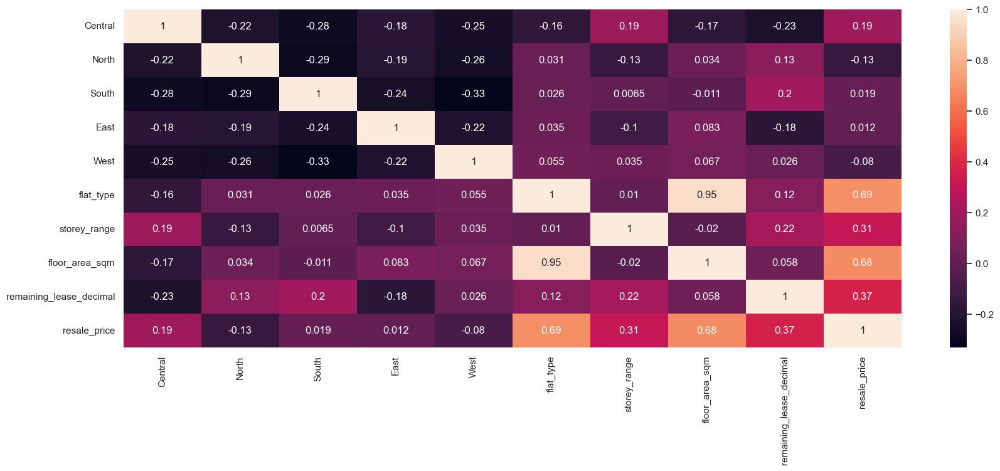

In [5]:
correlation_grid = resale_flat_data.corr()
plt.figure(figsize = (20,7))
sb.heatmap(correlation_grid, annot = True)

***Observing the Correlation grid,  we can tell that the resale price is highly correlated to the flat type, 0.69, and floor area, 0.68, which is expected. Among the locations, it seems to suggest that Central region flats have the highest correlation to resale flat price suggesting that flats there are more expensive. In contrast, it also says that flats on the north are the cheapest as it shows a negative correlation.***

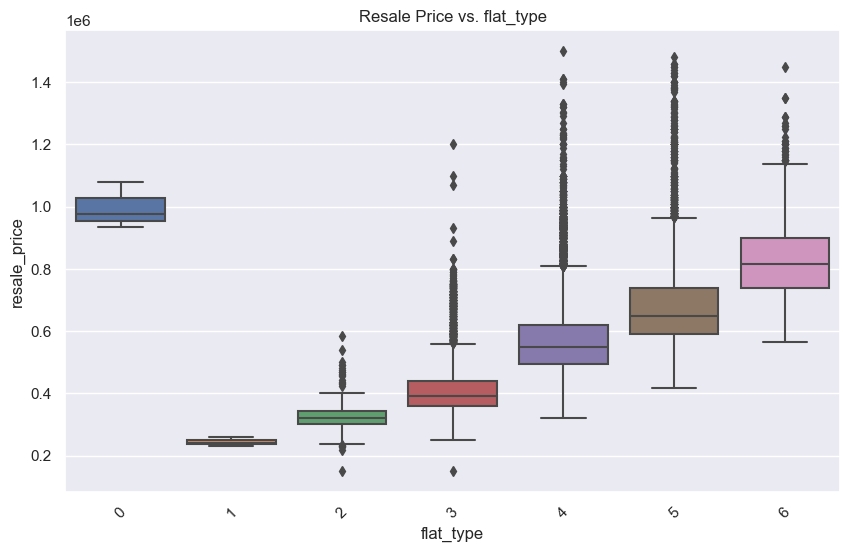

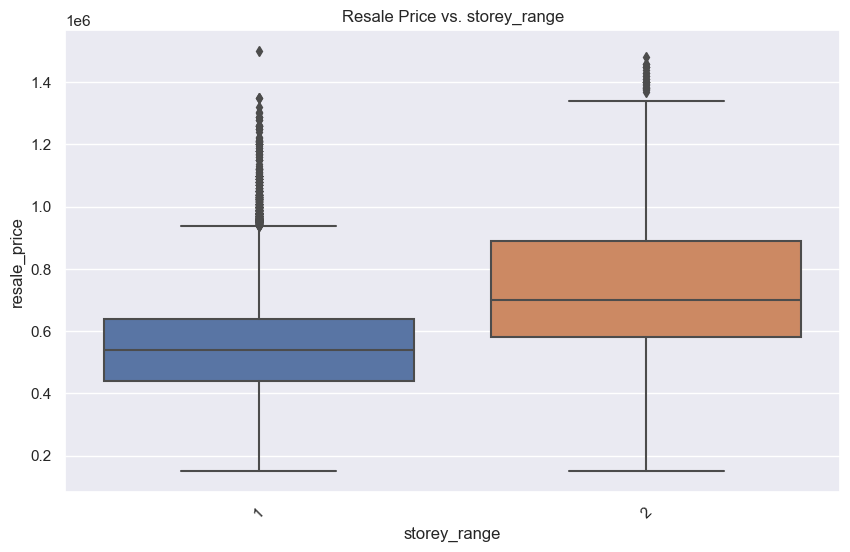

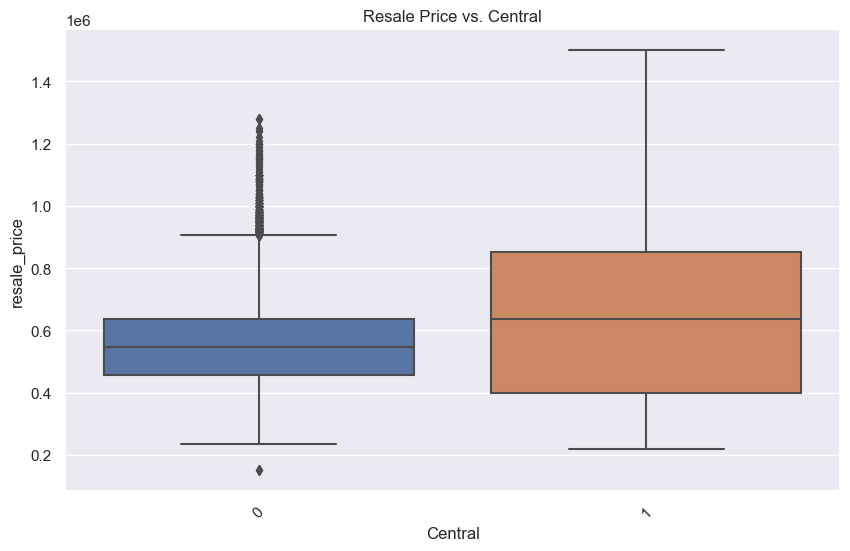

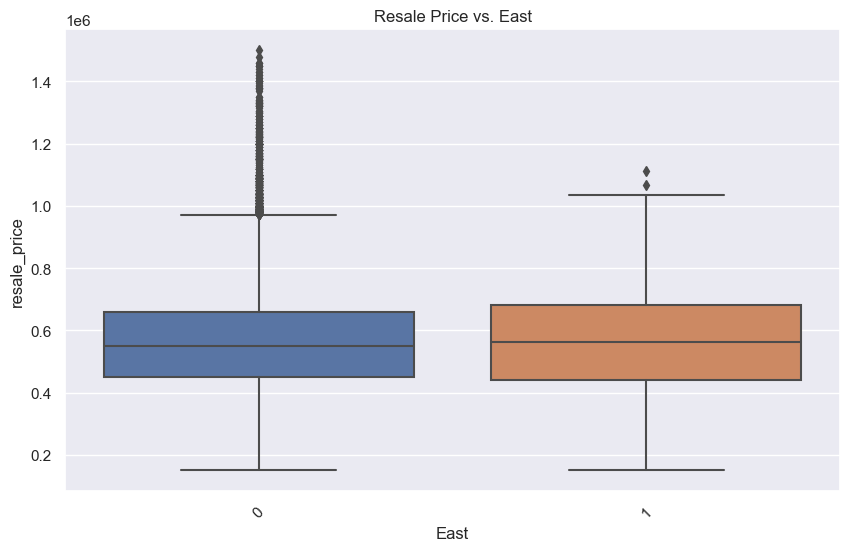

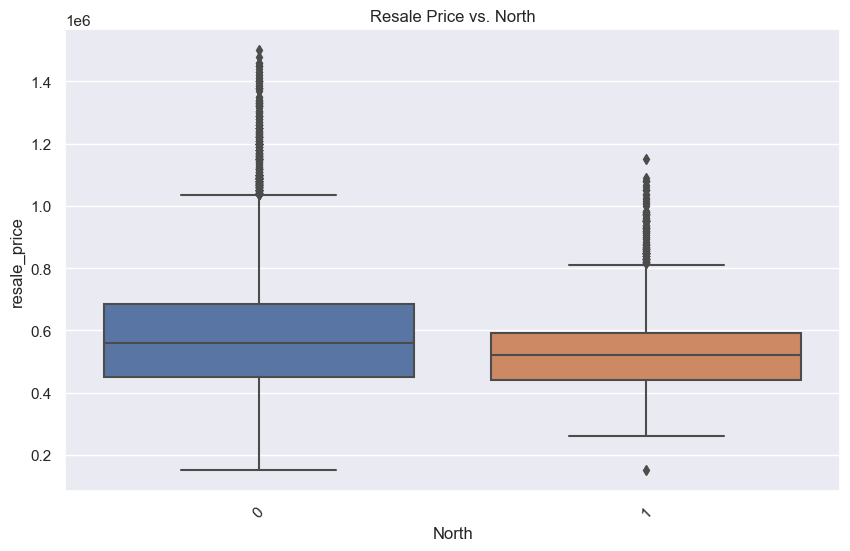

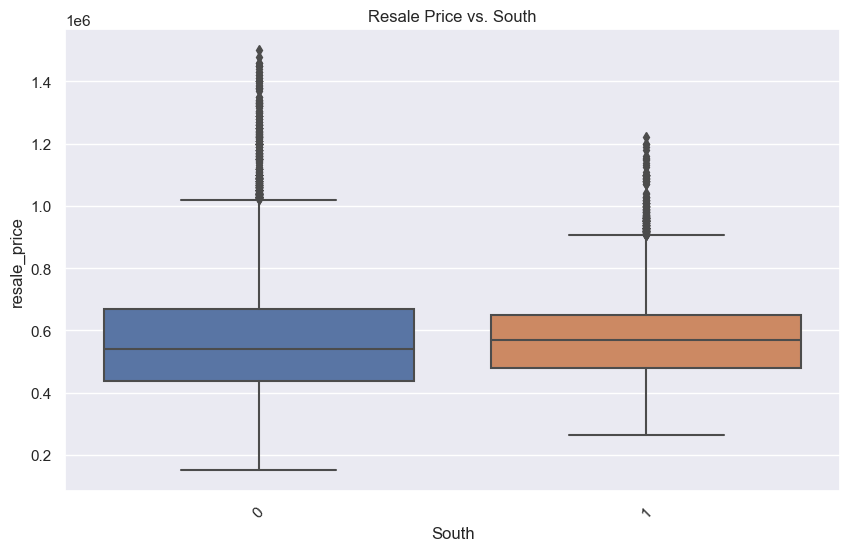

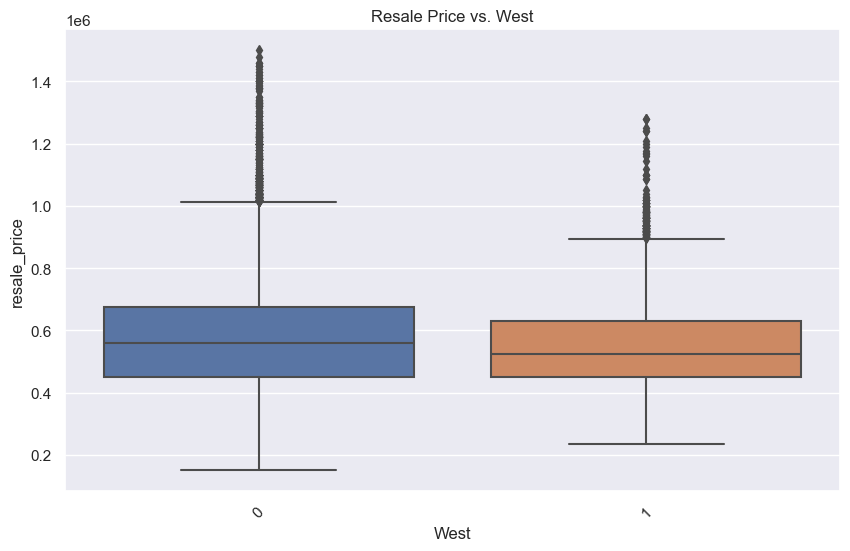

In [6]:
categorical_var = ['flat_type', 'storey_range', 'Central', 'East', 'North', 'South', 'West']
continuous_var = ['floor_area_sqm', 'remaining_lease_decimal']

for var in categorical_var:
    plt.figure(figsize=(10, 6))
    sb.boxplot(x=var, y='resale_price', data=resale_flat_data)
    plt.title(f'Resale Price vs. {var}')
    plt.xticks(rotation=45)
    plt.show()


***The following box plots help to visualise the distribution of resale price in each category. For those locations, only focus on the "1" boxplot. As expected, the 3 room and 4 room flat types have the highest frequency. The most expensive house is a 4 room flat as seen by that one outlier.****

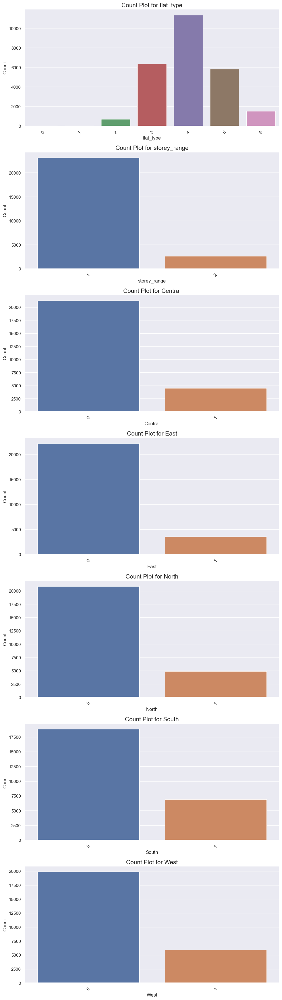

In [7]:
f, axes = plt.subplots(len(categorical_var), 1, figsize=(10, 5*len(categorical_var)))

# Iterate through the list of categorical variables
for i, var in enumerate(categorical_var):
    # Generate a count plot for each variable
    sb.countplot(x=var, data=resale_flat_data, ax=axes[i])
    axes[i].set_title(f'Count Plot for {var}', fontsize=15)
    axes[i].set_xlabel(var, fontsize=12)
    axes[i].set_ylabel('Count', fontsize=12)
    axes[i].tick_params(axis='x', rotation=45)  # Rotate x-axis labels for better readability

plt.tight_layout()  # Adjust layout to make room for the rotated x-axis labels
plt.show()

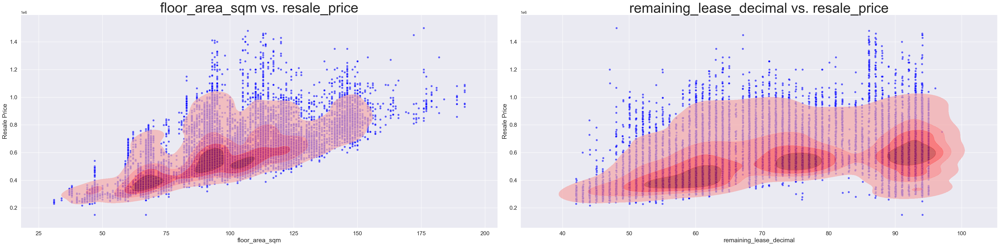

In [8]:
count = 0
f, axes = plt.subplots(1, 2, figsize=(40, 10))

for var in continuous_var:
    # Scatter plot for each variable against resale_price
    sb.scatterplot(data=resale_flat_data, x=var, y='resale_price', ax=axes[count], color='blue', alpha=0.6)

    # KDE plot for the joint distribution of each variable with resale_price
    sb.kdeplot(data=resale_flat_data, x=var, y='resale_price', ax=axes[count], color='red', levels=5, alpha=0.7, fill=True)
    
    axes[count].set_title(f'{var} vs. resale_price', fontsize=40)  # Increase title font size
    axes[count].set_xlabel(var, fontsize=18)  # Increase x-axis label font size
    axes[count].set_ylabel('Resale Price', fontsize=18)  # Increase y-axis label font size
    
    # Increasing tick labels font size
    axes[count].tick_params(axis='both', which='major', labelsize=16)
    count += 1

plt.tight_layout()
plt.show()

***The first graph shows the relationship between the Floor Area and Resale Price. We can see that the most saturated part of the graph occurs between approximately 60 m^2 and 110 m^2, with 80-90 m^2 being the most. This makes sense as those floor areas are typically of 3 room and 4 rooms flats, the most common type of housing in SG.*** 

***Similarly, in the second graph, there are 3 distinct hotspots: 55-65 years, 75-80 years, 90-99 years. Most people purchase house leases with at least 80 years so that they can profit off it from the future. The 55-65 years hotspot supports the trend in SG where older couples/families are purchasing houses with lower leases.***

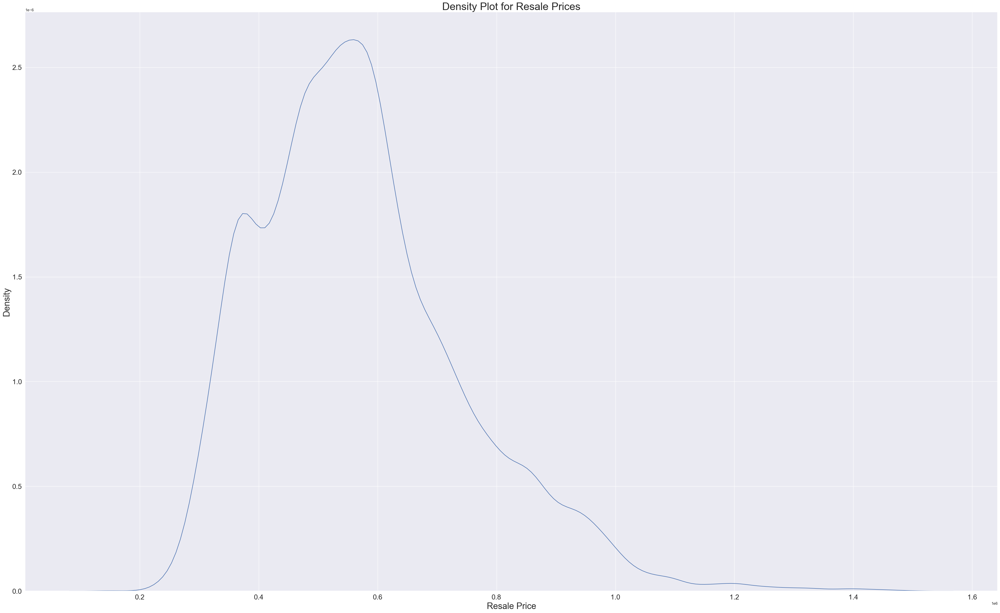

In [9]:
f, ax = plt.subplots(figsize=(50, 30))

sb.kdeplot(data=resale_flat_data['resale_price'], ax=ax).set(title='Density Plot for Resale Prices', xlabel='Resale Price', ylabel='Density')
ax.title.set_fontsize(30)  # Setting title font size
ax.xaxis.label.set_fontsize(25)  # Setting x-axis label font size
ax.yaxis.label.set_fontsize(25)  # Setting y-axis label font size

# Setting tick label font size
ax.tick_params(axis='both', which='major', labelsize=20)

plt.show()



***From this distribution, we can see that most flats cost around SGD400,000 to SGD600,000***

## Data Cleaning

***As we know, sometimes a resale flat could be sold for astrononmical prices due to sudden demand based of a variety of factors of which some are unpredictable and out of control. As such, to get a proper, average understanding of the data, it's best to remove outliers in the resale flat prices***

In [10]:
Q1 = resale_flat_data['resale_price'].quantile(0.25)
Q3 = resale_flat_data['resale_price'].quantile(0.75)
IQR = Q3 - Q1

# Define the criteria for being an outlier
outliers = (resale_flat_data['resale_price'] < (Q1 - 1.5 * IQR)) | (resale_flat_data['resale_price'] > (Q3 + 1.5 * IQR))

# Filter the DataFrame to remove outliers
resale_clean = resale_flat_data[~outliers]

print(resale_clean.head())

print(resale_clean.shape)

   Central  North  South  East  West  flat_type  storey_range  floor_area_sqm  \
0        0      0      1     0     0          2             1            44.0   
1        0      0      1     0     0          2             1            49.0   
2        0      0      1     0     0          2             1            44.0   
3        0      0      1     0     0          2             1            44.0   
4        1      0      0     0     0          3             1            64.0   

   remaining_lease_decimal  resale_price  
0                    55.05      267000.0  
1                    53.06      300000.0  
2                    54.01      280000.0  
3                    54.01      282000.0  
4                    62.01      508000.0  
(25205, 10)


***Number of rows has now reduced to 25,205***

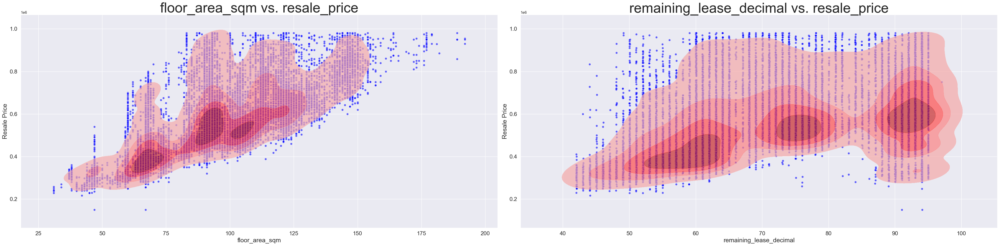

In [11]:
count = 0
f, axes = plt.subplots(1, 2, figsize=(40, 10))

for var in continuous_var:
    # Scatter plot for each variable against resale_price
    sb.scatterplot(data=resale_clean, x=var, y='resale_price', ax=axes[count], color='blue', alpha=0.6)

    # KDE plot for the joint distribution of each variable with resale_price
    sb.kdeplot(data=resale_clean, x=var, y='resale_price', ax=axes[count], color='red', levels=5, alpha=0.7, fill=True)
    
    axes[count].set_title(f'{var} vs. resale_price', fontsize=40)  # Increase title font size
    axes[count].set_xlabel(var, fontsize=18)  # Increase x-axis label font size
    axes[count].set_ylabel('Resale Price', fontsize=18)  # Increase y-axis label font size
    
    # Increasing tick labels font size
    axes[count].tick_params(axis='both', which='major', labelsize=16)
    count += 1

plt.tight_layout()
plt.show()

***After removing outliers, we can see in the first graph that the distribution between flat area and resale price has shifted. Those very expensive flats for an average flat area have been removed. Now, the highest resale price doesn't exceed SGD1,000,000 whie before it went up to SGD1,400,000.***

***Similarly, after removing outliers, the second graph od distribution between remaining lease and resale price seems more spread out now. This suggests that the dataset now has an even distribution of average values as opposed to earlier where the outliers cause the distribution to be too concentrated. Once again, the most expensine flat now is SGD1,000,000.***

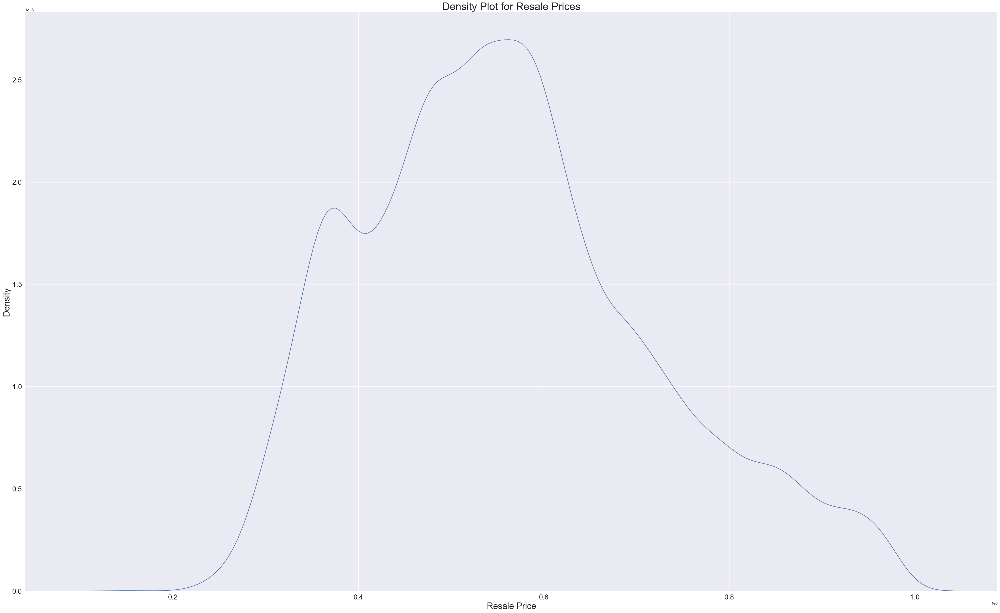

In [12]:
f, ax = plt.subplots(figsize=(50, 30))

sb.kdeplot(data=resale_clean['resale_price'], ax=ax).set(title='Density Plot for Resale Prices', xlabel='Resale Price', ylabel='Density')
ax.title.set_fontsize(30)  # Setting title font size
ax.xaxis.label.set_fontsize(25)  # Setting x-axis label font size
ax.yaxis.label.set_fontsize(25)  # Setting y-axis label font size

# Setting tick label font size
ax.tick_params(axis='both', which='major', labelsize=20)

plt.show()



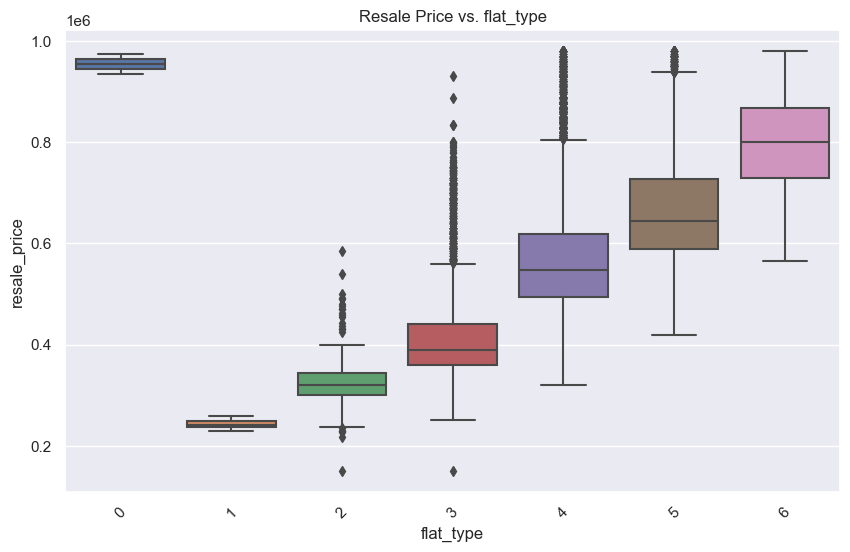

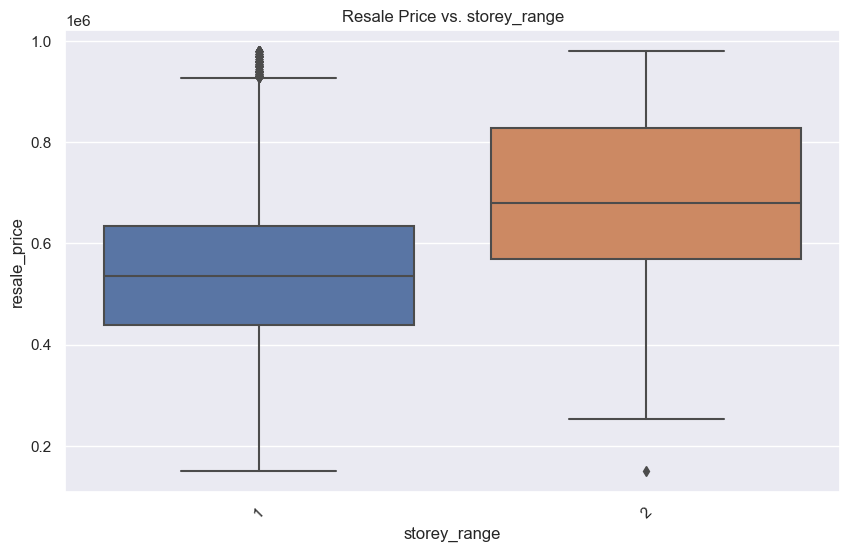

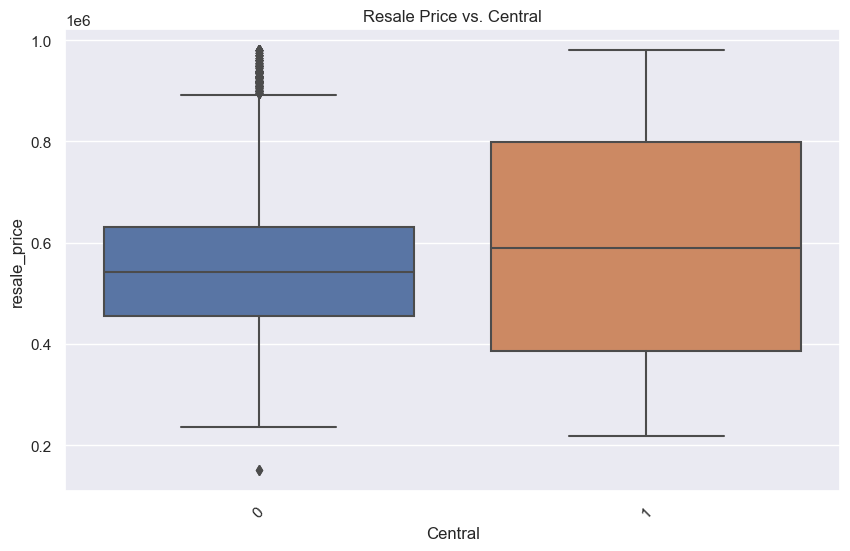

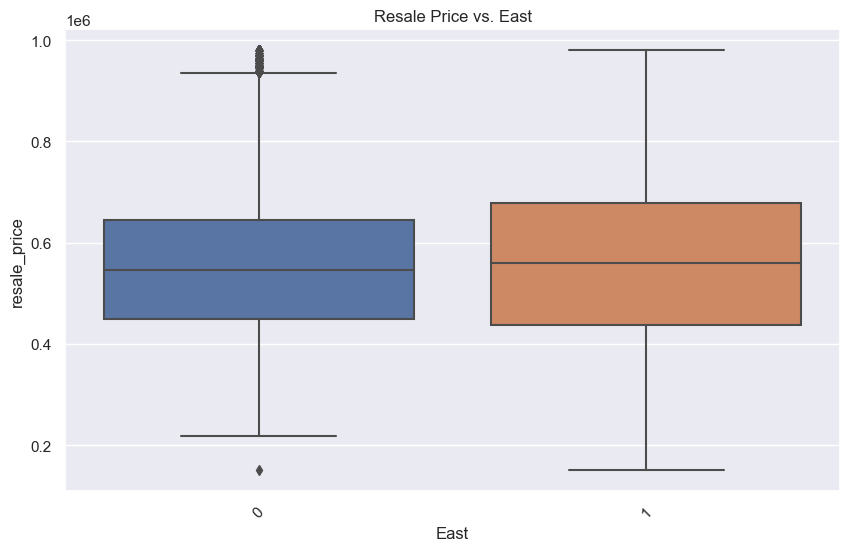

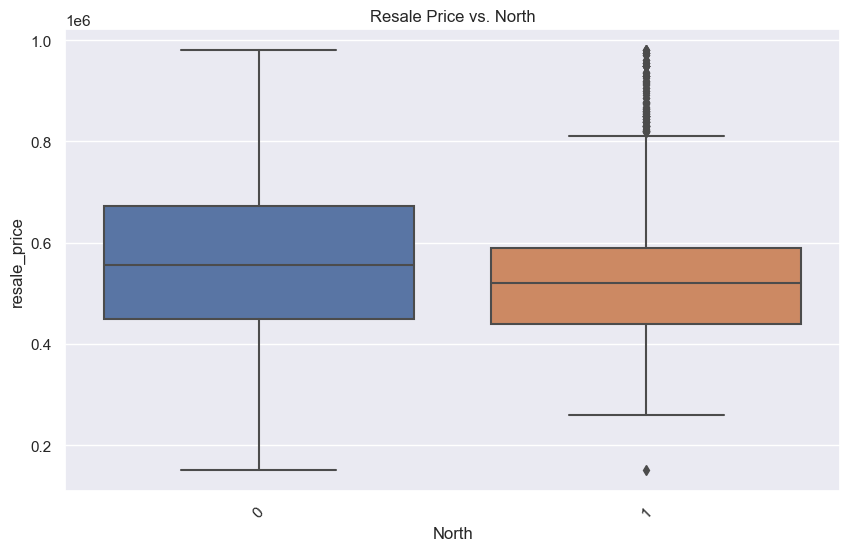

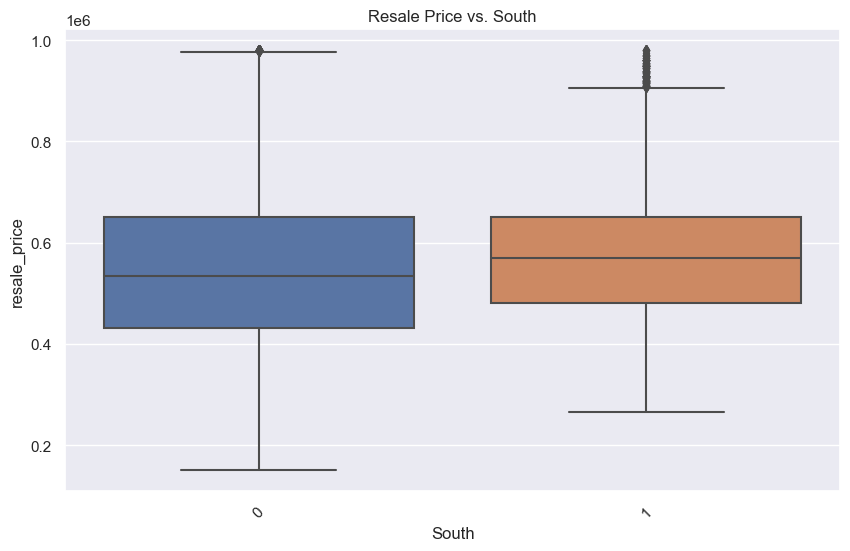

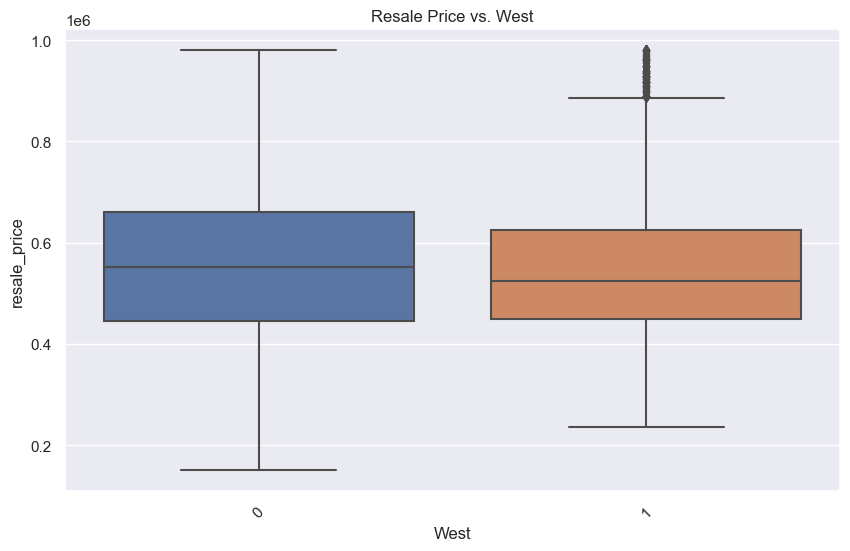

In [13]:

for var in categorical_var:
    plt.figure(figsize=(10, 6))
    sb.boxplot(x=var, y='resale_price', data=resale_clean)
    plt.title(f'Resale Price vs. {var}')
    plt.xticks(rotation=45)
    plt.show()

***This is the box plot distribuiton of each categorical variable against resale price. Notice how for flat type, the outliers, especially for 4 room flats, have reduced. This helps the dataset to omit those out of the ordinary flat prices that might have been inflated for other reasons***

## After all the analysis of the data, the next step would be to fit our clean data into the machine learning models which can then help us to predict the resale prices of the houses based on all the given variables. The models that we would be using are as follows:
1. linear regression, 
2. decision tree regressor with grid search 
3. random forest with grid search.

# 1. Multi-Variate Linear Regression 

We started off with linear regression as our base model to address our problem of a supervised training set consisting of continuous dependant variable, and a mix between continuous and categorical independant variables which were one-hot encoded

### TrainTest Split

We started by splitting our data into train and test set as well as independent and dependent variables

In [14]:
x = resale_clean[['Central', 'East', 'North', 'South', 'flat_type', 'storey_range', 'floor_area_sqm', 'remaining_lease_decimal']]
y = resale_clean["resale_price"]

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.20, random_state = 42)

print("Train Set :", y_train.shape, x_train.shape)
print("Test Set  :", y_test.shape, x_test.shape)

# TO REMOVE
print(x.head())



Train Set : (20164,) (20164, 8)
Test Set  : (5041,) (5041, 8)
   Central  East  North  South  flat_type  storey_range  floor_area_sqm  \
0        0     0      0      1          2             1            44.0   
1        0     0      0      1          2             1            49.0   
2        0     0      0      1          2             1            44.0   
3        0     0      0      1          2             1            44.0   
4        1     0      0      0          3             1            64.0   

   remaining_lease_decimal  
0                    55.05  
1                    53.06  
2                    54.01  
3                    54.01  
4                    62.01  


In [15]:
feature_names = x.columns.tolist()

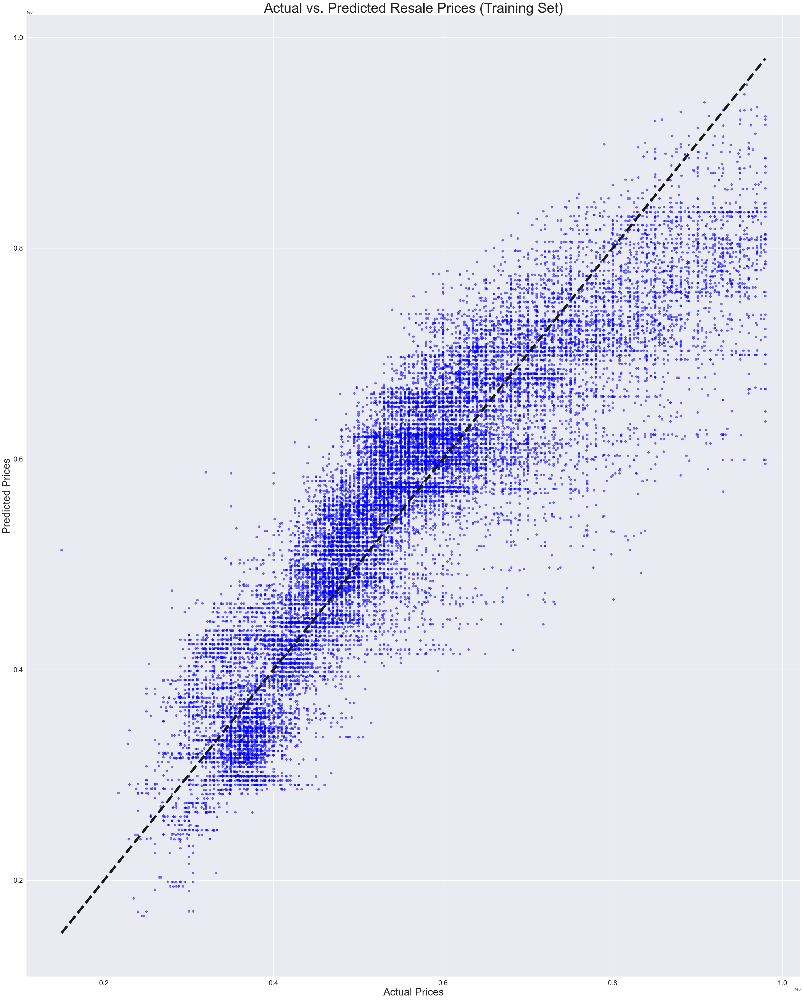

In [16]:
lr = LinearRegression()
lr.fit(x_train, y_train)

lr_y_train_pred = lr.predict(x_train)
lr_y_test_pred = lr.predict(x_test)



plt.figure(figsize=(40, 50))
plt.scatter(y_train, lr_y_train_pred, color='blue', alpha=0.5)  # Added alpha for better visualization of point density

# Increasing the font size for the title and axis labels
plt.title('Actual vs. Predicted Resale Prices (Training Set)', fontsize=40)
plt.xlabel('Actual Prices', fontsize=30)
plt.ylabel('Predicted Prices', fontsize=30)

# Making the best-fit line thicker and more visible
plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=7)  # Increased line width to 4

# Increasing the font size of the tick labels
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

plt.show()


The regression model would form a linear relationship between the predictors and response variable which in our case would be the price of resale houses. All the scatterplots represent the predicted value while the dotted line across represents the true values. From the diagram, we can see that all the predicted points are scattered around the true values.

In [17]:

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Explained Variance (R^2) \t:", r2_score(y_train, lr_y_train_pred))
print("Explained Variance (R^2) \t:", lr.score(x_train, y_train))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_train, lr_y_train_pred))
print()

Goodness of Fit of Model 	Train Dataset
Explained Variance (R^2) 	: 0.7942039518070801
Explained Variance (R^2) 	: 0.7942039518070801
Mean Squared Error (MSE) 	: 4995156874.011603



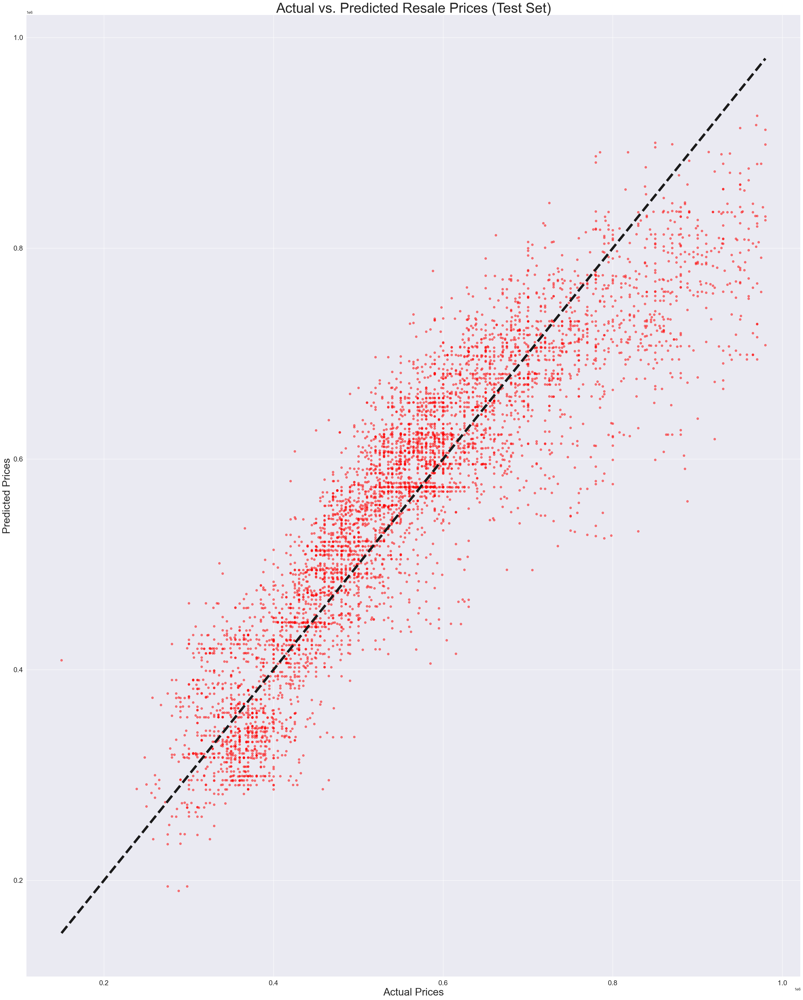

In [18]:
# Plot for the test data
plt.figure(figsize=(40, 50))
plt.scatter(y_test, lr_y_test_pred, color='red', alpha=0.5)
plt.title('Actual vs. Predicted Resale Prices (Test Set)', fontsize=40)
plt.xlabel('Actual Prices')
plt.ylabel('Predicted Prices')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=7)  # Diagonal line indicating perfect predictions
plt.xlabel('Actual Prices', fontsize=30)
plt.ylabel('Predicted Prices', fontsize=30)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.show()

This is how our regression model performs on the test set.

In [19]:
# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Explained Variance (R^2) \t:", r2_score(y_test, lr_y_test_pred))
print("Explained Variance (R^2) \t:", lr.score(x_test, y_test))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, lr_y_test_pred))

Goodness of Fit of Model 	Test Dataset
Explained Variance (R^2) 	: 0.8039573738695427
Explained Variance (R^2) 	: 0.8039573738695427
Mean Squared Error (MSE) 	: 4757397048.2488985


In [20]:
#Evaluating Key metrics
n = x_train.shape[0]
p = x_train.shape[1]
r2_lr_train = r2_score(y_train, lr_y_train_pred)
adjusted_r2_lr_train = 1 - (1 - r2_lr_train) * ((n - 1) / (n - p - 1))

n = x_test.shape[0]
p = x_test.shape[1]
r2_lr_test = r2_score(y_test, lr_y_test_pred)
adjusted_r2_lr_test = 1 - (1 - r2_lr_test) * ((n - 1) / (n - p - 1))

mse_lr = mean_squared_error(y_test, lr_y_test_pred)
mae_lr = mean_absolute_error(y_test, lr_y_test_pred)

In [21]:
print("\nMetrics:")
print(f"r2_train: {r2_lr_train}")
print(f"Adjusted R^2: {adjusted_r2_lr_train}")
print(f"r2_test: {r2_lr_test}")
print(f"Adjusted R^2: {adjusted_r2_lr_test}")
print(f"MSE: {mse_lr}")
print(f"MAE: {mae_lr}")


Metrics:
r2_train: 0.7942039518070801
Adjusted R^2: 0.7941222664493256
r2_test: 0.8039573738695427
Adjusted R^2: 0.8036457003780794
MSE: 4757397048.2488985
MAE: 52936.209277091504


In order to determine the goodness of fit of our models, we decided to focus on a few factors namely explained variance, adjusted explained variance, mean squared error and mean absolute error. By comparing the regression model on both the test and train set, we can see that the model is not overfitted and can predict the prices to a relatively high accuracy.

In [22]:
coefficients = pd.DataFrame(lr.coef_.flatten(), index=x.columns, columns=['Coefficient'])
coefficients_sorted = coefficients.abs().sort_values(by='Coefficient', ascending=False)
print(coefficients_sorted)

                           Coefficient
Central                  163639.152657
storey_range              75584.237261
East                      64176.859880
South                     28048.036745
flat_type                 22791.895447
North                     21692.401010
remaining_lease_decimal    4289.807535
floor_area_sqm             4232.029399


## Central:  
166,221.01 SGD - Properties in the Central region, on average, are  166,221 SGD more expensive than properties in the West (the reference category), holding all other factors constant.

## East: 
65,025.87 SGD - Properties in the East region are, on average, 65,026 SGD more expensive than those in the West, all else being equal.

## South: 
30,008.45 SGD - Properties in the South region are, on average, 30,008 SGD more expensive than those in the West, all else being equal.

## North:
20,597.60 SGD - Properties in the North region are, on average, 20,598 SGD more expensive than those in the West, all else being equal.

## Floor Area (sqm): 
4,254.81 SGD - Each additional square meter of floor area is associated with an increase of approximately 4,255 SGD in the resale price, suggesting that larger properties command higher prices.

## Remaining Lease (decimal): 
4,262.06 SGD - Each additional year in the remaining lease term increases the resale price by about 4,262 SGD. This indicates that properties with longer leases are more valuable, which is a common trend in real estate markets where lease duration impacts property value.

## Storey Range: 
76,054.93 SGD - This coefficient suggests that properties classified under a higher storey range (represented by "2") are, on average, 76,055 SGD more expensive than those in a lower storey range (represented by "1"). This aligns with typical real estate trends where higher floors often command premium prices due to better views, less noise, etc.

## Flat Type: 
22,497.04 - Each incremental increase in flat type category (from 1-room to 6-room flats) is associated with an increase of about 22,497 SGD in the resale price. This progression reflects the increasing value of larger flats within the same location and other conditions being constant.

#### Location Premiums: Highlight that location significantly influences property values, with Central and East showing substantial premiums over the reference category (West). This can be useful for real estate investors or buyers looking for properties with high appreciation potential.

#### Property Characteristics: Emphasize the value added by larger floor areas and longer leases, which are crucial for buyers and sellers to consider during transactions.

#### Storey and Flat Type Premiums: Discuss how properties on higher floors and larger flat types not only provide more living space but also significantly enhance the resale value, which could influence buyer preferences and investment decisions.

## Why we decided to use decision tree 

For our second model, we decided to use decision tree as decision trees are easy to understand and interpret. They can handle both categorical and numerical variables which makes them well suited for our data set. Decision trees can not only handle classification tasks as we have learned in class but also regression tasks as in our case where we are trying to predict the resale housing prices. Furthermore, using decision tree can also allow us to determine and analyse what are the more significant factors which affects the pricing of houses the most. As compared to regression models, decision tress can also handle non-linear relationships from the data which is largely relevant to us as not all variables have a clear linear relationship with price. 
When building and training our decision tree, we realised how well the model performs largely depend on the hyperparameter values of it. Since there is no way for us to physically determine in advance what are the most optimal values, we have to try all possible combinations of the values to see which would yield a highest goodness of fit with our data. However, with the vast amount of data points and possible combinations of the parameters, doing it manually would be inpractical and inefficient which is why we decided to use GridSearchCV. GridSearchCV uses internal cross validation to automate the tuning of the hyperparameters, largely improving the accuracy of our model. In this case, we specified and standardized 3 folds cross-validation for our model given the large number of data that we have.

## Gridsearch Parameters 

- To tune the hyperparameters of our Decision Tree, as well as to account for data visibility, we decided to limit the maximum depth of the tree to 5. 
- The other variables, such as min_samples_split and min_samples_leaf were adjusted from a range of 1 to 40, as recommended in this paper: The Elements of Statistical learning https://hastie.su.domains/Papers/ESLII.pd
- The maximum features to be considered at each node were set as sqrt, log2, and max features(8), owing to conflicting accounts of optimal max_features.
- Finally, for scoring we decided to use the negative mean squared error function to calculate the best score. 

- We chose Mean Squared Error as the value to determine accuracy because it is a practical and objective evaluation of the model's prediction errors in relation to price. 

- R^2 score, or the goodness of fit, was considered but it merely reflects the variance on the model, which was not our main focus from the model's outputs

# DecisionTreeRegressor with GridSearch w/o Outliers

In [23]:
param_grid = {
    'max_depth':[3,4,5], 
    'min_samples_split': [2,5,10], 
    'min_samples_leaf': [1,2,5],
    'max_features': [8,'sqrt']
}

In [24]:
gs_dtr = GridSearchCV(estimator=DTRegressor(), param_grid=param_grid, cv=3, scoring='neg_mean_squared_error')
gs_dtr.fit(x_train, y_train)
print('Best parameters found:', gs_dtr.best_params_)
print('Best score (neg_mean_squared_error):', gs_dtr.best_score_)

Best parameters found: {'max_depth': 5, 'max_features': 8, 'min_samples_leaf': 1, 'min_samples_split': 2}
Best score (neg_mean_squared_error): -4584057745.90001


In [25]:
dtr = DTRegressor(max_depth=5, min_samples_split = 2, min_samples_leaf = 1, max_features = 8, random_state = 42)
dtr.fit(x_train,y_train)
print("Train Set :", x_train.shape, y_train.shape)
print("Test Set :", x_test.shape, y_test.shape)

Train Set : (20164, 8) (20164,)
Test Set : (5041, 8) (5041,)


In [26]:
dtr_y_pred_train = dtr.predict(x_train)
dtr_y_pred_test = dtr.predict(x_test)  

In [27]:
dtr.fit(x_train,y_train)
f = plt.figure(figsize=(100, 100))
plot_tree(dtr, filled=True, rounded=True, feature_names= feature_names)
dtr_y_pred_train = dtr.predict(x_train)
dtr_y_pred_test = dtr.predict(x_test)


This is another data visualization method, using dtreeviz.model. This code installs dtreeviz locally to allow dtreeviz to run within the ipynb. However, the environment path to graphviz has to be installed locally, the steps being detailed in the github notes for dtreeviz representation. 
https://github.com/parrt/dtreeviz/blob/master/README.md

In [28]:
import sys
!{sys.executable} -m pip install -q dtreeviz
import dtreeviz

In [29]:
viz = dtreeviz.model(dtr, X_train=x_train, y_train = y_train, feature_names = feature_names, target_name = "resale_price")
v = viz.view()
v

C:\Users\Vidret\anaconda3\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names


1. The horizontal dashed lines indicate the target mean for the left and right buckets in decision nodes;
2. A vertical dashed line indicates the split point in feature space.
3. The black wedge highlights the split point and identifies the exact split value.
4. Leaf nodes indicate the target prediction (mean) with a dashed line.

- This visuallization makes it easier to follow how certain splits lead to certain values, say you already have factors in mind like remaining lease less than 76.57 years, central, flooor area more than 55 sqm, and a flat type of 4 rooms the average resale price would be around 760 k. Of course more splits will lead to more specific results, and hence more accurate resale price predictions. 

#Optional image downloading process tp convert to code to download image (convert to code)
v.show()
v.save("/tmp/iris.svg")

In [30]:
# Evaluating Key Metrics
n = x_train.shape[0]
p = x_train.shape[1]
r2_dtr_train = r2_score(y_train, dtr_y_pred_train)
adjusted_r2_dtr_train = 1 - (1 - r2_dtr_train) * ((n - 1) / (n - p - 1))

n = x_test.shape[0]
p = x_test.shape[1]
r2_dtr_test = r2_score(y_test, dtr_y_pred_test)
adjusted_r2_dtr_test = 1 - (1 - r2_dtr_test) * ((n - 1) / (n - p - 1))

mse_dtr = mean_squared_error(y_test, dtr_y_pred_test)
mae_dtr = mean_absolute_error(y_test, dtr_y_pred_test)

In [31]:
print("\nMetrics:")
print(f"r2_train: {r2_dtr_train}")
print(f"Adjusted R^2: {adjusted_r2_dtr_train}")
print(f"r2_test: {r2_dtr_test}")
print(f"Adjusted R^2: {adjusted_r2_dtr_test}")
print(f"MSE: {mse_dtr}")
print(f"MAE: {mae_dtr}")


Metrics:
r2_train: 0.8140256621488318
Adjusted R^2: 0.8139518445004661
r2_test: 0.8143347413008185
Adjusted R^2: 0.8140395660087689
MSE: 4505567850.89213
MAE: 48121.339561724126


- Using the same factors for the goodness of fit, we can see that firstly the accuracy of the model on the train and test is relatively close to each other which represent that the decision tree is not overfitted and it allows for a accurate prediction of the resale prices. Secondly, based on the goodness of fit of both the decision tree and and our regression model, we can see that our decision tree is a more accurate predicting model, likely due to the non-linear relationships between the variables. 

# RandomForestRegressor with Gridsearch W/O Outliers

* The next model we decided to use was RandomForestRegressor as random forest uses an ensemble learning method in which it combines many decision tress to make predictions. Each decision tree in the forest is trained independently on a subset of the data and features. By combining the predictions of multiple trees, random forests can reduce the variance in predictions and improve the overall prediction accuracy. Furthermore Random forests are also less prone to overfitting and can better handle complex data. 


In [32]:
param_grid = {
    'max_depth': [3,4,5],
    'min_samples_split': [2,5,10], 
    'min_samples_leaf': [1,2,5],
    'max_features': [8,'sqrt'],
    'n_estimators':[200,800,1600],
}

In [48]:
# Initialize GridSearchCV
gs_rfr = GridSearchCV(estimator=RFRegressor(), param_grid=param_grid, scoring='neg_mean_squared_error', cv=3, n_jobs = -1)

# Fit GridSearchCV on the training data
gs_rfr.fit(x_train, y_train)

# Best parameters and best score
print("Best parameters found:", gs_rfr.best_params_)
print("Best score found (neg_mean_squared_error):", gs_rfr.best_score_)


KeyboardInterrupt: 

- Based on running the Gridsearch, the best parameters have been found to be 
    1. max_depth = 5
    2. min_samples_split = 5
    3. min_samples_leaf = 5
    4. max_features = 8
    5. n_estimators: 200

In [46]:
#rfr = RFRegressor(max_depth=5, min_samples_split=gs_rfr.best_params_['min_samples_split'],
                             #min_samples_leaf=gs_rfr.best_params_['min_samples_leaf'])
rfr = RFRegressor(max_depth = 5, min_samples_split = 5, min_samples_leaf = 5, n_estimators = 200, max_features = 8)
rfr.fit(x_train,y_train)
print("Train Set :", x_train.shape, y_train.shape)
print("Test Set :", x_test.shape, y_test.shape)

Train Set : (20164, 8) (20164,)
Test Set : (5041, 8) (5041,)


In [35]:
rfr_y_pred_train = rfr.predict(x_train)
rfr_y_pred_test = rfr.predict(x_test)

In [36]:
# Evaluating key metrics
n = x_train.shape[0]
p = x_train.shape[1]
r2_rfr_train = r2_score(y_train, rfr_y_pred_train)
adjusted_r2_rfr_train = 1 - (1 - r2_rfr_train) * ((n - 1) / (n - p - 1))

n = x_test.shape[0]
p = x_test.shape[1]
r2_rfr_test = r2_score(y_test, rfr_y_pred_test)
adjusted_r2_rfr_test = 1 - (1 - r2_rfr_test) * ((n - 1) / (n - p - 1))

mse_rfr = mean_squared_error(y_test, rfr_y_pred_test)
mae_rfr = mean_absolute_error(y_test, rfr_y_pred_test)


In [37]:
print("\nMetrics:")
print(f"r2_train: {r2_rfr_train}")
print(f"Adjusted R^2: {adjusted_r2_rfr_train}")
print(f"r2_test: {r2_rfr_test}")
print(f"Adjusted R^2: {adjusted_r2_rfr_test}")
print(f"MSE: {mse_rfr}")
print(f"MAE: {mae_rfr}")


Metrics:
r2_train: 0.8195150707255419
Adjusted R^2: 0.8194434319543091
r2_test: 0.8197324672652633
Adjusted R^2: 0.8194458734135388
MSE: 4374580391.290268
MAE: 47389.64419467602


# Training Curves

- However, accounting for the limitations imposed on the depth of each tree, how much can the accuracy potentially increase with deeper trees? 
- To answer this, we performed grid search to determine the effects of changing a single parameter, max depth, over testing set accuracy and training time. 

In [38]:
def plot_results(model, param='max_depth', name='Depth of Trees'):
    param_name = f'param_{param}'  # Python f-string for better readability

    # Extract information from the cross-validation model
    test_scores = model.cv_results_['mean_test_score']
    train_time = model.cv_results_['mean_fit_time']
    param_values = [p[param] for p in model.cv_results_['params']]
    # Setting up plots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

    # Plotting test scores
    ax1.plot(param_values, test_scores, 'go-', label='Test Scores')
    ax1.set_xlabel(name)
    ax1.set_ylabel('Neg Mean Squared Error')
    ax1.set_title(f'Score vs {name}')
    ax1.legend()
    ax1.grid(True)
    ax1.set_xlim()
    ax1.set_ylim()
    # Plotting training times
    ax2.plot(param_values, train_time, 'ro-')
    ax2.set_xlabel(name)
    ax2.set_ylabel('Train Time (sec)')
    ax2.set_title(f'Training Time vs {name}')
    ax2.grid(True)

    # Automatically adjust y-limits based on data
    ax1.set_ylim(np.min(test_scores) * 1.1, np.max(test_scores) * 0.9)
    ax2.set_ylim(0, np.max(train_time) * 1.1)

    plt.tight_layout(pad=4)
    plt.show()

Fitting 3 folds for each of 7 candidates, totalling 21 fits


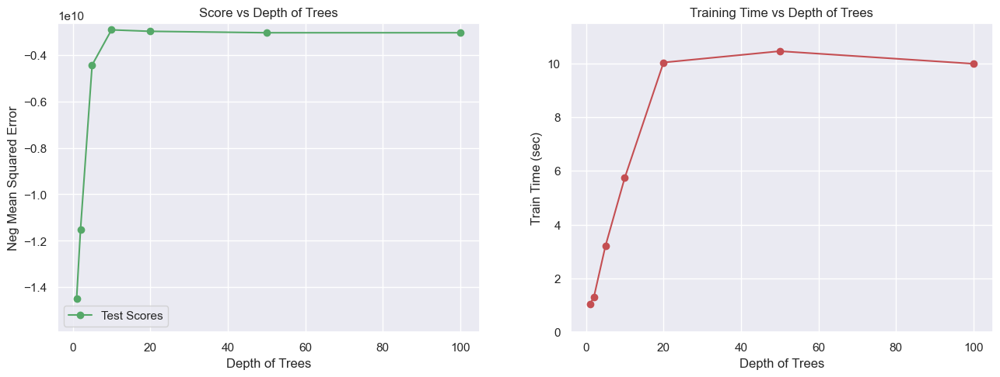

In [39]:
rfr = RandomForestRegressor(random_state=42)
tree_grid = {'max_depth': [1,2,5,10,20,50,100]}
tree_grid_search = GridSearchCV(estimator=rfr, param_grid=tree_grid, verbose=2, n_jobs=-1, cv=3, scoring='neg_mean_squared_error')
tree_grid_search.fit(x_train, y_train)

# Plot results
plot_results(tree_grid_search, param='max_depth', name='Depth of Trees')

- Based on the results, we decided to narrow the depth of the tree to a range of 3-20, 

Fitting 3 folds for each of 18 candidates, totalling 54 fits


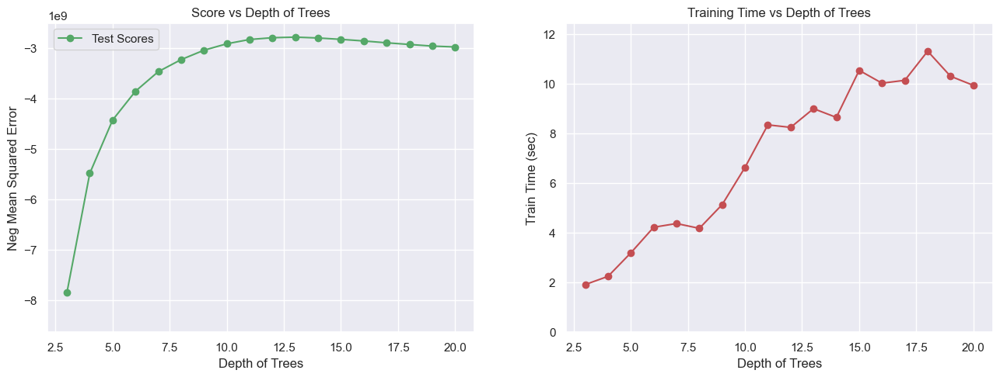

In [40]:
rfr = RandomForestRegressor(random_state=42)
tree_grid = {'max_depth': [int(x) for x in np.linspace(3, 20,18)]}
tree_grid_search = GridSearchCV(estimator=rfr, param_grid=tree_grid, verbose=2, n_jobs=-1, cv=3, scoring='neg_mean_squared_error')
tree_grid_search.fit(x_train, y_train)

# Plot results
plot_results(tree_grid_search, param='max_depth', name='Depth of Trees')

- We found out that 13 would be the most optimal depth of the tree and hence used it to potentially maximise the accuracy of the Decision Tree and Random Forest

In [41]:
rfr = RFRegressor(max_depth = 13, min_samples_split = 5, min_samples_leaf = 5, n_estimators = 200, max_features = 8, random_state = 42)
rfr.fit(x_train,y_train)
max_rfr_y_pred_train = rfr.predict(x_train)
max_rfr_y_pred_test = rfr.predict(x_test)
n = x_train.shape[0]
p = x_train.shape[1]
r2_max_rfr_train = r2_score(y_train, max_rfr_y_pred_train)
adjusted_r2_max_rfr_train = 1 - (1 - r2_max_rfr_train) * ((n - 1) / (n - p - 1))

n = x_test.shape[0]
p = x_test.shape[1]
r2_max_rfr_test = r2_score(y_test, max_rfr_y_pred_test)
adjusted_r2_max_rfr_test = 1 - (1 - r2_max_rfr_test) * ((n - 1) / (n - p - 1))

mse_max_rfr = mean_squared_error(y_test, max_rfr_y_pred_test)
mae_max_rfr = mean_absolute_error(y_test, max_rfr_y_pred_test)
print("\nTest Set Metrics:")
print(f"r2_train: {r2_max_rfr_train}")
print(f"Adjusted R^2: {adjusted_r2_max_rfr_train}")
print(f"r2_test: {r2_max_rfr_test}")
print(f"Adjusted R^2: {adjusted_r2_max_rfr_test}")
print(f"MSE: {mse_max_rfr}")
print(f"MAE: {mae_max_rfr}")


Test Set Metrics:
r2_train: 0.912740173223012
Adjusted R^2: 0.9127055377174692
r2_test: 0.8946277063167121
Adjusted R^2: 0.8944601827973427
MSE: 2557085919.684118
MAE: 35063.40050405438


In [42]:
dtr = DTRegressor(max_depth=13, min_samples_split = 2, min_samples_leaf = 1, max_features = 8, random_state = 42)
dtr.fit(x_train,y_train)
max_dtr_y_pred_train = dtr.predict(x_train)
max_dtr_y_pred_test = dtr.predict(x_test)
n = x_train.shape[0]
p = x_train.shape[1]
r2_max_dtr_train = r2_score(y_train, max_dtr_y_pred_train)
adjusted_r2_max_dtr_train = 1 - (1 - r2_max_dtr_train) * ((n - 1) / (n - p - 1))

n = x_test.shape[0]
p = x_test.shape[1]
r2_max_dtr_test = r2_score(y_test, max_dtr_y_pred_test)
adjusted_r2_max_dtr_test = 1 - (1 - r2_max_dtr_test) * ((n - 1) / (n - p - 1))

mse_max_dtr = mean_squared_error(y_test, max_dtr_y_pred_test)
mae_max_dtr = mean_absolute_error(y_test, max_dtr_y_pred_test)
print("\nTest Set Metrics:")
print(f"r2_train: {r2_max_dtr_train}")
print(f"Adjusted R^2: {adjusted_r2_max_dtr_train}")
print(f"r2_test: {r2_max_dtr_test}")
print(f"Adjusted R^2: {adjusted_r2_max_dtr_test}")
print(f"MSE: {mse_max_dtr}")
print(f"MAE: {mae_max_dtr}")


Test Set Metrics:
r2_train: 0.9259453800953087
Adjusted R^2: 0.9259159860511887
r2_test: 0.8760622905833279
Adjusted R^2: 0.8758652512996765
MSE: 3007615764.916554
MAE: 37319.69320919983


# Results


In [43]:
results = pd.DataFrame([
    ['LinearRegressor without Outliers', r2_lr_train, adjusted_r2_lr_train, r2_lr_test, adjusted_r2_lr_test, mse_lr, mae_lr],
    ['Depth05_DecisionTreeRegressor with Gridsearch', r2_dtr_train, adjusted_r2_dtr_train, r2_dtr_test, adjusted_r2_dtr_test, mse_dtr, mae_dtr],
    ['Depth05_RandomForestRegressor with Gridsearch', r2_rfr_train, adjusted_r2_rfr_train, r2_rfr_test, adjusted_r2_rfr_test, mse_rfr, mae_rfr],
    ['Depth13_DecisionTreeRegressor with Gridsearch', r2_max_dtr_train, adjusted_r2_max_dtr_train, r2_max_dtr_test, adjusted_r2_max_dtr_test, mse_max_dtr, mae_max_dtr],
    ['Depth13_RandomForestRegressor with Gridsearch', r2_max_rfr_train, adjusted_r2_max_rfr_train, r2_max_rfr_test, adjusted_r2_max_rfr_test, mse_max_rfr, mae_max_rfr]
],
columns=['Model', 'R² on Train', 'Adjusted R² on Train', 'R² on Test', 'Adjusted R² on Test', 'Mean Squared Error', 'Mean Absolute Error'])
results

,Model,R² on Train,Adjusted R² on Train,R² on Test,Adjusted R² on Test,Mean Squared Error,Mean Absolute Error
0,LinearRegressor without Outliers,0.794204,0.794122,0.803957,0.803646,4.757397e+09,52936.209277
1,Depth05_DecisionTreeRegressor with Gridsearch,0.814026,0.813952,0.814335,0.814040,4.505568e+09,48121.339562
2,Depth05_RandomForestRegressor with Gridsearch,0.819515,0.819443,0.819732,0.819446,4.374580e+09,47389.644195
3,Depth13_DecisionTreeRegressor with Gridsearch,0.925945,0.925916,0.876062,0.875865,3.007616e+09,37319.693209
4,Depth13_RandomForestRegressor with Gridsearch,0.912740,0.912706,0.894628,0.894460,2.557086e+09,35063.400504


- As seen from the values and as per what is generated from grid search, using trees of depth 13 significantly increases the prediction accuracy of both decision tree and random forest which is expected as deeper trees can take into account more variables and can capture more complex relationships within the variables. 

- However, as seen by the data, increasing the depth of the trees make the trees more sensitive to variations in the training data, meaning that it would perform better on the training set as compared to the test, implying slight overfitting. 

- By comparing, we believe that the difference of 0.05 between the explained variance on the train and test sets for decision tree where the model is certainly still a more accurate prediction model than if we were to use the tree depth of 5. 

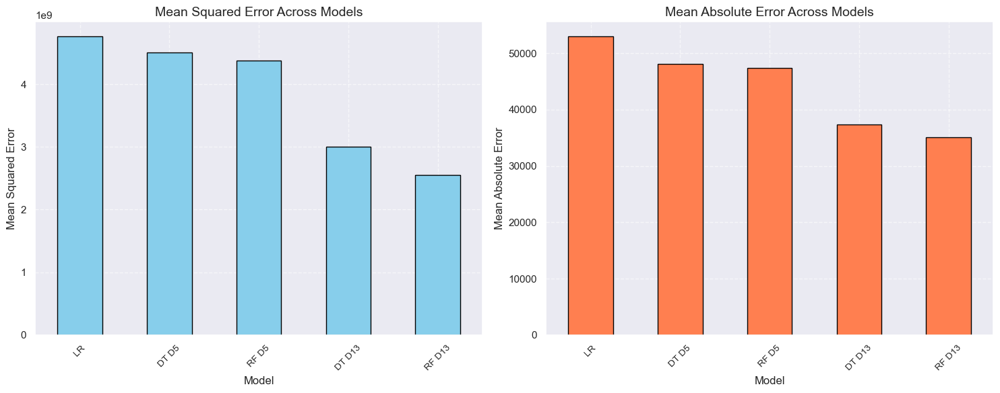

In [44]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Custom labels for the models
custom_labels = ['LR', 'DT D5', 'RF D5', 'DT D13', 'RF D13']

# Plotting Mean Squared Error on the first subplot
results['Mean Squared Error'].plot(kind='bar', color='skyblue', edgecolor='black', ax=ax1)
ax1.set_title('Mean Squared Error Across Models', fontsize=14)
ax1.set_ylabel('Mean Squared Error', fontsize=12)
ax1.set_xlabel('Model', fontsize=12)
ax1.set_xticks(range(len(custom_labels)))  # Set x-ticks positions
ax1.set_xticklabels(custom_labels, rotation=45, fontsize=10)  # Set custom x-tick labels
ax1.grid(True, linestyle='--', alpha=0.6)

# Plotting Mean Absolute Error on the second subplot
results['Mean Absolute Error'].plot(kind='bar', color='coral', edgecolor='black', ax=ax2)
ax2.set_title('Mean Absolute Error Across Models', fontsize=14)
ax2.set_ylabel('Mean Absolute Error', fontsize=12)
ax2.set_xlabel('Model', fontsize=12)
ax2.set_xticks(range(len(custom_labels)))  # Set x-ticks positions
ax2.set_xticklabels(custom_labels, rotation=45, fontsize=10)  # Set custom x-tick labels
ax2.grid(True, linestyle='--', alpha=0.6)

plt.tight_layout()
plt.show()

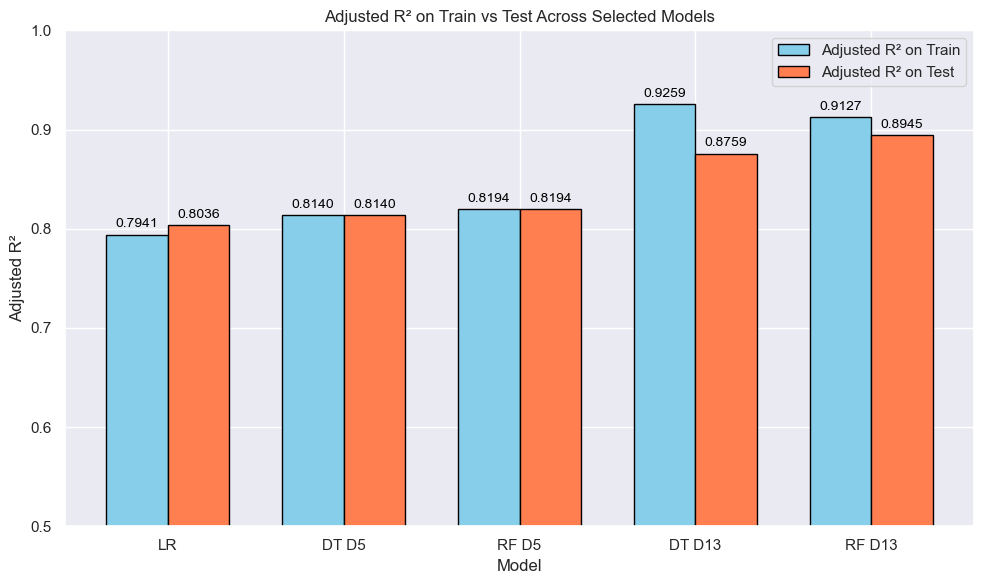

In [47]:
from matplotlib.ticker import FuncFormatter

# Define a custom formatter function
def two_decimal_places(x, pos):
    """The two arguments are the value and tick position."""
    return f'{x:.2f}'
results = results.iloc[:5]  # Adjust this as per the actual DataFrame contents if necessary

# Parameters for the bars
bar_width = 0.35
index = np.arange(len(results))

fig, ax = plt.subplots(figsize=(10, 6))

# Plotting the Adjusted R² for Train and Test with specified colors
train_bars = ax.bar(index, results['Adjusted R² on Train'], bar_width, label='Adjusted R² on Train', color='skyblue', edgecolor='black')
test_bars = ax.bar(index + bar_width, results['Adjusted R² on Test'], bar_width, label='Adjusted R² on Test', color='coral', edgecolor='black')

# Adding text labels for clarity on differences
for bars in [train_bars, test_bars]:
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f'{height:.4f}',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom', fontsize=10, color='black')

# Set the labels and titles
ax.set_xlabel('Model')
ax.set_ylabel('Adjusted R²')
ax.set_ylim(0.5,1)
ax.set_title('Adjusted R² on Train vs Test Across Selected Models')
ax.set_xticks(index + bar_width / 2)
ax.set_xticklabels(custom_labels, rotation=0)  

ax.legend()
plt.tight_layout()
plt.show()

# Conclusion:

- Among the 3 machine learning models that we used, random forest is the model that has the highest prediction accuracy out of the 3. 
- This aligns with our expectations and understanding of the models as random forest is a complex model as compared to linear regression and decision tree. 
- While linear regression is very frequently used, it lacks in considering non-linear relationship between the variables which is where decision trees can come into play. 
- However, the depth of decision trees have to be properly maintained as it could lead to overfitting, increased computational complexity and decreased generalisation performance, which can then make the model less accurate. 
- That being said, random forest comprises of many decision trees which can each take into account different factors before using all the predictions of each tree to make a final prediction therefore, random forest would more often than not generate the highest prediction accuracy.


# Learning Process:

- We were concerned that the decision tree could explain the data more than the random forest, as we were expecting the random forest to outperform the decision tree across all the metrics used. However, owing to the significantly worse mean squared error and the difference in explained variance over test, we chalked it up to the overfitting of the decision tree on higher tree depths. 
- Fundamentally, when deciding the most optimal values to use for gridsearch we were fascinated by how much the explained variance increased if parameters such as 2000 estimators or trees of depth 20 were used, with the highest value being 0.95. (depth 20, estimators = 2000, min samples split and min samples leaf = 2 and 1 respectively), but we decided to settle on a systematic approach to choose the best Gridsearch Parameters.
- When doing research, we came across several other hyperparameter tuning models such as random search and bayesian model-based optimization, but we settled with gridsearch owing to its reliability (random search constantly gives different values and is anyway used to narrow down gridsearch values) as well as practicality (bayesian optimization was too complicated, and inputting specific arrrays from 0-100 or 200 to 2000 with increments of 200 led to crashes or extremely long waiting hours for the gridsearch process (imagine 10 folds)). Also, we do acknowledge the merits of cleaning of data to remove variables that had little to no effect on the price. However, we settled with our chosen parameters as a decent compromise between efficieny and accuracy
- More modern visualization models like dtreeviz required some digging as the API changed from usual, and recommended codes to use dtreeviz did not work. Successfully implementing the visuallization in this code was really educational, and we learnt much from looking at the parameters of each model and how they should affect our models in the context of our problem 
- Some hidden variables, such as bootstrap and splitter were useful to know as well, where splitter for example determines the best feature to split based on gini or entropy. Random State 42 was used to pay homage to the 'answer' of the entire universe in THHttG :)